# Part 0 - Libraries and Geoinfo file upload

## Available data analysis NYC information

In [1]:
#first import needed libraries
import numpy as np # numpy arrays
import pandas as pd # dataframes and many many other things
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe
import json # work with json files
import requests #make requests to urls

import urllib #open urls

! pip install folium
import folium

# installed shapely library from a wheel file - https://www.lfd.uci.edu/~gohlke/pythonlibs/
# instruction to install library into conda using cmd - https://www.geeksforgeeks.org/python-add-packages-to-anaconda-environment/
!pip install shapely
import shapely
import shapely.wkt

from shapely import geometry

import geopy.distance

import ast # for transforming strings to the list/tuple

First we take data related to the New-york city (NYC from now on) Neighborhood tabulation areas (NTAs) <br>
For this I've searched the internet and got to the valuable site, and this directory https://www1.nyc.gov/site/planning/data-maps/open-data/dwn-nynta.page <br>
https://data.cityofnewyork.us/City-Government/New-York-City-Population-By-Neighborhood-Tabulatio/swpk-hqdp/data <br>
here we've found population amounts by NTAs, so we definetely can calculate the population density based on this information. <br>
and income information by NTA 'http://www.city-data.com/nbmaps/neigh-New-York-New-York.html'
'https://statisticalatlas.com/place/New-York/New-York/Household-Income#figure/neighborhood'

In [2]:
url_geoinfo='http://services5.arcgis.com/GfwWNkhOj9bNBqoJ/arcgis/rest/services/nynta/FeatureServer/0/query?where=1=1&outFields=*&outSR=4326&f=geojson'
with urllib.request.urlopen(url_geoinfo) as ref_geoinfo:
    json_geoinfo=json.load(ref_geoinfo)

json_geoinfo.keys()

dict_keys(['type', 'crs', 'features'])

# Part 1 - preparation of open source New-york city data

So, we've stumbled upon the infromation regarding the shapes of the NYC NTAs <br>
Luckily, I've found __shapely__ library to work with the shape objects, understand if some venue (ll point) is inside a shape, <br> 
calculate area sizes and find centroids of the NTAs

In [3]:
# after research of the json file's structure, let's see one element example
print(json_geoinfo['features'][0].keys())
print(json_geoinfo['features'][0]['properties'].keys())

dict_keys(['type', 'id', 'geometry', 'properties'])
dict_keys(['OBJECTID', 'BoroCode', 'BoroName', 'CountyFIPS', 'NTACode', 'NTAName', 'Shape__Area', 'Shape__Length'])


In [4]:
# now let's create a dataframe that holds all the shapes and desired infromation regarding the shapes
shape_tlist=[]
shape_clist=[]
shape_ntalist=[]
shape_arealist=[]
shape_countlist=[]
for i,elem in enumerate(json_geoinfo['features']):
    shape_type=elem['geometry']['type']
    shape_tlist.append(shape_type)
    shape_ntalist.append(elem['properties']['NTACode'])
    shape_arealist.append(elem['properties']['Shape__Area']/10000000)
    #print(i,shape_type)
    shape_coord=elem['geometry']['coordinates'];
    if shape_type=='Polygon':
        shape_obj=geometry.Polygon(shape_coord[0])
        i=1
    elif shape_type=='MultiPolygon':
        #print(shape_coord[1])
        shape_multi=[]
        i=0
        for shape_elem in shape_coord:
            for shape_detail in shape_elem:
                i+=1
                shape_multi.append(geometry.Polygon(shape_detail))
        shape_obj=geometry.MultiPolygon(shape_multi)
    else:
        shape_obj='NA'
    shape_clist.append(shape_obj)
    shape_countlist.append(i)
df_NTA=pd.DataFrame(zip(shape_ntalist,shape_tlist, shape_countlist,shape_clist,shape_arealist), columns=['NTA Code','Shape type','Poly Count','geometry','Shape area size, km'])
df_NTA.set_index('NTA Code',inplace=True)
df_NTA.tail()

,Shape type,Poly Count,geometry,"Shape area size, km"
NTA Code,,,,
BX37,Polygon,1,"POLYGON ((-73.8312929784187 40.8554423953868, ...",3.630226
BX49,Polygon,1,"POLYGON ((-73.83682058862399 40.8572851002081,...",2.303272
BX99,MultiPolygon,19,"(POLYGON ((-73.8695589388133 40.8161681686262,...",22.084138
BX14,Polygon,1,"POLYGON ((-73.90958869860999 40.8427646600875,...",1.822245
BX63,Polygon,1,"POLYGON ((-73.91191954925161 40.8432661715556,...",1.937972


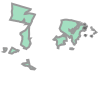

In [5]:
df_NTA['geometry'].loc['BX99']
#that's how a shapely multipolygon object is displayed - in comparison with the map, this is the parks in bronx

## This concludes our first task - to extract the infromation regarding how the neighborhoods look like
Next, we're going to calculate based on the shapes, what is the square area size, what are the centroids of the noted shapes, and what are the max distance from every shape point to it's centroid (we're gonna need it when we'll extract the data from FourSquare)

In [6]:
# also there is an error between built-in shape area size and polygon area simply because the Earth isn't flat, so you need to keep in mind of such inaccuracy and how it can affect your calculation
df_NTA['Polygon area, km']=df_NTA['geometry'].apply(lambda x:x.area*10000)

#second - let's point out centroids (or a list of centroids for polygons)
def multi_centroid(multi_shape):
    cent_list=[]
    for poly in multi_shape:
        cent_list.append(poly.centroid.coords[0])
    return cent_list

df_NTA.loc[df_NTA['Poly Count']>1,'Shape centroid']=df_NTA.loc[df_NTA['Poly Count']>1,'geometry'].apply(lambda x:multi_centroid(x))
df_NTA.loc[df_NTA['Poly Count']==1,'Shape centroid']=df_NTA.loc[df_NTA['Poly Count']==1,'geometry'].apply(lambda x:x.centroid.coords[0])

#third - let's calculate the the farthest point inside each polygon from the centroid, and that we did with the notion of the earth parameters, even if we've made the algorithm a little longer by it

def farthest_determinator(poly_shape):
    cent=poly_shape.centroid
    max=0
    for ll in poly_shape.exterior.coords:
        if max<geopy.distance.geodesic(ll, (cent.x,cent.y)).km:
            max=geopy.distance.geodesic(ll, (cent.x,cent.y)).km
    return max

def multi_far(multi_shape):
    max_list=[]
    for poly in multi_shape:
        max_list.append(farthest_determinator(poly))
    return max_list

df_NTA.loc[df_NTA['Poly Count']>1,'Max radius, km']=df_NTA.loc[df_NTA['Poly Count']>1,'geometry'].apply(lambda x:multi_far(x))
df_NTA.loc[df_NTA['Poly Count']==1,'Max radius, km']=df_NTA.loc[df_NTA['Poly Count']==1,'geometry'].apply(lambda x:farthest_determinator(x))

df_NTA.head()

,Shape type,Poly Count,geometry,"Shape area size, km","Polygon area, km",Shape centroid,"Max radius, km"
NTA Code,,,,,,,
BK88,Polygon,1,"POLYGON ((-73.9760507905698 40.6312841471042, ...",5.400502,5.340402,"(-73.98866266868872, 40.63095789636294)",2.08888
QN51,Polygon,1,"POLYGON ((-73.8037916164017 40.7756183875692, ...",5.248828,5.201031,"(-73.80954728991074, 40.7683598620414)",2.17119
QN27,Polygon,1,"POLYGON ((-73.8610986495631 40.7636727481715, ...",1.972695,1.954586,"(-73.86839700576594, 40.763360472288284)",1.55927
QN07,Polygon,1,"POLYGON ((-73.7572580842358 40.7181468677945, ...",2.288777,2.265990,"(-73.76113842090989, 40.71064759845558)",1.21384
MN06,Polygon,1,"POLYGON ((-73.94607972264011 40.8212714957943,...",1.064708,1.055791,"(-73.95378343034275, 40.81798384495018)",0.920667


# Now we're taking the information regarding the population size by NTA's from another source
Unfortunately, the latest infrormaton available is 2010, but We'll try to look for additional infromation later on

In [7]:
url_population='https://data.cityofnewyork.us/api/views/swpk-hqdp/rows.csv'
df_population=pd.read_csv(url_population)
df_population=df_population.loc[df_population['Year']==2010]
df_population.reset_index(drop=True,inplace=True)
df_population.set_index('NTA Code',inplace=True)

df_merged=df_population.join(df_NTA,on='NTA Code')
df_merged.head()

,Borough,Year,FIPS County Code,NTA Name,Population,Shape type,Poly Count,geometry,"Shape area size, km","Polygon area, km",Shape centroid,"Max radius, km"
NTA Code,,,,,,,,,,,,
BX01,Bronx,2010,5,Claremont-Bathgate,31078,Polygon,1,"POLYGON ((-73.8903909601717 40.8546973463029, ...",1.645162,1.631985,"(-73.90031732179924, 40.84275747344604)",1.25663
BX03,Bronx,2010,5,Eastchester-Edenwald-Baychester,34517,Polygon,1,"POLYGON ((-73.8236698820197 40.8899120377269, ...",4.025679,3.995702,"(-73.83664470142585, 40.88094356403927)",4.87072
BX05,Bronx,2010,5,Bedford Park-Fordham North,54415,Polygon,1,"POLYGON ((-73.8836265993054 40.8672658784137, ...",1.499888,1.488426,"(-73.89018505698733, 40.86769038128258)",1.22561
BX06,Bronx,2010,5,Belmont,27378,Polygon,1,"POLYGON ((-73.8830952421818 40.8666104758242, ...",1.355734,1.345175,"(-73.88586860224872, 40.85778821036361)",0.671094
BX07,Bronx,2010,5,Bronxdale,35538,Polygon,1,"POLYGON ((-73.8613806529038 40.8713448048408, ...",1.518561,1.506874,"(-73.86490241828254, 40.86401307181572)",0.940301


In [8]:
df_borough_pop=df_merged[['Shape area size, km','Polygon area, km','Borough']].groupby(by='Borough').sum()
# Polygon area had been calculated in order to check the reasonableness of the default built-in shape area size information, however the differences are caused by
# the fact that you cannot just calculate the area size of 2D object, because the Earth is not flat
df_borough_pop

,"Shape area size, km","Polygon area, km"
Borough,,
Bronx,118.661402,117.728211
Brooklyn,193.759621,192.069654
Manhattan,63.659370,63.088019
Queens,304.477964,301.432838
Staten Island,162.392277,160.465357


In [9]:
#df_borough_pop.drop('Polygon area, km',axis=1,inplace=True)
df_merged.drop('Polygon area, km',axis=1,inplace=True)

## In the next step, we're gonna look for additional information sourses and check the provided data quality based on external information
Like - the borough area sizes from wikipedia

In [10]:
# now we double check the data with aggregated Borough information available (couldn't find information for every NTA)
from bs4 import BeautifulSoup
url_wiki='https://en.wikipedia.org/wiki/Boroughs_of_New_York_City'
wiki_html=urllib.request.urlopen(url_wiki).read()
wiki_soup=BeautifulSoup(wiki_html,'html.parser')
#wiki_soup.prettify()

In [11]:
soup_table = wiki_soup.find('table',{'class':'wikitable sortable'})
#so then, after we locate the table, we only take that relevant part, and find every text line by searching 'td'
soup_links=soup_table.findAll('td')
columns=['Borough', 'County', 'Population','GDP US bln','GDP per capita','Area sq ml','Area sq km','Density sq ml','Density sq km']
NYC_borough_stat=pd.DataFrame(columns=columns)
temp_dict={}
for n,line in enumerate(soup_links):
#basically, every element in 'soup_links' is every cell in the table, and as we know there are 9 elements in every row, so we are configuring this algorithm to
#re-write a dictionary 'temp_dict' on every 9-rd iteration and append it to the created dataframe 'postal_codes'
    curr=line.get_text().strip('\n') # at this line - we're getting only relevant text without any html symbols and other things, also we're stripping the next line symbol
#this if is served for multi-purpose 1. if n%9==0 then the we've got the full temp_dict recorded that we need to record
# however if n==0, then we're at the start of the loop, and we don't have anything to write yet
# also it is given at the task that we need to delete all unassigned lists
    if (n%9==0) and (n!=0) and (temp_dict['Borough']!='Not assigned'):
# next if is to see when the Borough already had been recorded, so if the loc method with condition inside shows that it's empty - then we need to write a new line
        if NYC_borough_stat.loc[NYC_borough_stat['Borough']==temp_dict['Borough']].empty:
            NYC_borough_stat=NYC_borough_stat.append(temp_dict,ignore_index=True)
    temp_dict[columns[n%9]]=curr
    
# if a neighbourhood not assigned, then it must be replaced
NYC_borough_stat['Borough'].loc[0]='Bronx'
NYC_borough_stat.set_index('Borough',inplace=True)
NYC_borough_stat.head()

,County,Population,GDP US bln,GDP per capita,Area sq ml,Area sq km,Density sq ml,Density sq km
Borough,,,,,,,,
Bronx,Bronx,"1,471,160",28.787,"19,570",42.10,109.04,"34,653","13,231"
Brooklyn,Kings,"2,648,771",63.303,"23,900",70.82,183.42,"37,137","14,649"
Manhattan,New York,"1,664,727",629.682,"378,250",22.83,59.13,"72,033","27,826"
Queens,Queens,"2,358,582",73.842,"31,310",108.53,281.09,"21,460","8,354"
Staten Island,Richmond,"479,458",11.249,"23,460",58.37,151.18,"8,112","3,132"


In [12]:
# it seems like have some differences, and in order to minimize them, 
# let's create a normalizing square area coefficients for each borough and then apply it to the NTA information
df_borough_pop['stat area sq km']=NYC_borough_stat['Area sq km']
df_borough_pop['area_coef']=df_borough_pop.apply(lambda x: float(x['stat area sq km'])/float(x['Shape area size, km']), axis=1)
df_borough_pop

,"Shape area size, km","Polygon area, km",stat area sq km,area_coef
Borough,,,,
Bronx,118.661402,117.728211,109.04,0.918917
Brooklyn,193.759621,192.069654,183.42,0.946637
Manhattan,63.659370,63.088019,59.13,0.928850
Queens,304.477964,301.432838,281.09,0.923187
Staten Island,162.392277,160.465357,151.18,0.930956


In [13]:
try:
    df_merged.drop('area_coef',axis=1,inplace=True)
except:
    print('no area_coef column present_yet')
df_merged=df_merged.join(df_borough_pop['area_coef'],on='Borough')
df_merged['Area_normalized, sq km']=df_merged.apply(lambda x: float(x['area_coef'])*x['Shape area size, km'], axis=1)
df_merged.drop(['area_coef','Shape area size, km'],axis=1,inplace=True)
df_merged['Population_density']=df_merged.apply(lambda x: int(x['Population'])/float(x['Area_normalized, sq km']),axis=1)
df_merged.head()

no area_coef column present_yet


,Borough,Year,FIPS County Code,NTA Name,Population,Shape type,Poly Count,geometry,Shape centroid,"Max radius, km","Area_normalized, sq km",Population_density
NTA Code,,,,,,,,,,,,
BX01,Bronx,2010,5,Claremont-Bathgate,31078,Polygon,1,"POLYGON ((-73.8903909601717 40.8546973463029, ...","(-73.90031732179924, 40.84275747344604)",1.25663,1.511767,20557.397540
BX03,Bronx,2010,5,Eastchester-Edenwald-Baychester,34517,Polygon,1,"POLYGON ((-73.8236698820197 40.8899120377269, ...","(-73.83664470142585, 40.88094356403927)",4.87072,3.699266,9330.770030
BX05,Bronx,2010,5,Bedford Park-Fordham North,54415,Polygon,1,"POLYGON ((-73.8836265993054 40.8672658784137, ...","(-73.89018505698733, 40.86769038128258)",1.22561,1.378273,39480.562676
BX06,Bronx,2010,5,Belmont,27378,Polygon,1,"POLYGON ((-73.8830952421818 40.8666104758242, ...","(-73.88586860224872, 40.85778821036361)",0.671094,1.245807,21976.112362
BX07,Bronx,2010,5,Bronxdale,35538,Polygon,1,"POLYGON ((-73.8613806529038 40.8713448048408, ...","(-73.86490241828254, 40.86401307181572)",0.940301,1.395432,25467.377992


## Now, let's see aditional sourse of information regarding the income, population and other

In [14]:
import zipfile
import io

zip_url='https://s3.amazonaws.com/geoda/data/nycnhood_acs.zip'
zip_bytes=urllib.request.urlopen(zip_url).read()
#this is the zip file we need to open and iterate through it's contents
with zipfile.ZipFile(io.BytesIO(zip_bytes)) as my_zip_file:
    zinfo=my_zip_file.infolist()
    znames=my_zip_file.namelist()
znames
# so, now we can see, that we need to open the dbf file inside the zip file and shape object to see if they have more accurate data
# 2 files - 'NYC_Nhood ACS2008_12.dbf', 'NYC_Nhood ACS2008_12.shp', number 0 and 5

['NYC_Nhood ACS2008_12.dbf',
 '__MACOSX/',
 '__MACOSX/._NYC_Nhood ACS2008_12.dbf',
 'NYC_Nhood ACS2008_12.prj',
 '__MACOSX/._NYC_Nhood ACS2008_12.prj',
 'NYC_Nhood ACS2008_12.shp',
 '__MACOSX/._NYC_Nhood ACS2008_12.shp',
 'NYC_Nhood ACS2008_12.shx',
 '__MACOSX/._NYC_Nhood ACS2008_12.shx']

In [15]:
!pip install simpledbf
!pip install pyshp
from simpledbf import Dbf5
import shapefile

with zipfile.ZipFile(io.BytesIO(zip_bytes)) as my_zip_file:
    dbf_ref=my_zip_file.extract(zinfo[0])
    dbf=Dbf5(dbf_ref)
    df_dbf = dbf.to_dataframe()
    shp_ref=my_zip_file.extract(zinfo[5])
    shp = shapefile.Reader(shp_ref)
print(shp.fields)
df_dbf.head()
#zinfo[5]

[('DeletionFlag', 'C', 1, 0), ['UEMPRATE', 'N', 18, 7], ['cartodb_id', 'N', 18, 0], ['borocode', 'N', 9, 0], ['withssi', 'N', 9, 0], ['withsocial', 'N', 9, 0], ['withpubass', 'N', 9, 0], ['struggling', 'N', 9, 0], ['profession', 'N', 9, 0], ['popunemplo', 'N', 9, 0], ['poptot', 'N', 9, 0], ['popover18', 'N', 9, 0], ['popinlabou', 'N', 9, 0], ['poororstru', 'N', 9, 0], ['poor', 'N', 9, 0], ['pacificune', 'N', 9, 0], ['pacificinl', 'N', 9, 0], ['pacific', 'N', 9, 0], ['otherunemp', 'N', 9, 0], ['otherinlab', 'N', 9, 0], ['otherethni', 'N', 9, 0], ['onlyprofes', 'N', 9, 0], ['onlymaster', 'N', 9, 0], ['onlylessth', 'N', 9, 0], ['onlyhighsc', 'N', 9, 0], ['onlydoctor', 'N', 9, 0], ['onlycolleg', 'N', 9, 0], ['onlybachel', 'N', 9, 0], ['okay', 'N', 9, 0], ['mixedunemp', 'N', 9, 0], ['mixedinlab', 'N', 9, 0], ['mixed', 'N', 9, 0], ['master', 'N', 9, 0], ['maleunempl', 'N', 9, 0], ['maleover18', 'N', 9, 0], ['male_pro', 'N', 9, 0], ['male_mastr', 'N', 9, 0], ['male_lesHS', 'N', 9, 0], ['male_

,UEMPRATE,cartodb_id,borocode,withssi,withsocial,withpubass,struggling,profession,popunemplo,poptot,...,ntaname,boroname,popdty,ntacode,medianinco,medianagem,medianagef,medianage,HHsize,gini
0,0.095785,1,3,652,5067,277,6421,889,2225,48351,...,Georgetown-Marine Park-Bergen Beach-Mill Basin,Brooklyn,497498.701,BK45,1520979,663.3,777.1,722.6,2.96421052631579,0.386315789473684
1,0.090011,2,3,2089,7132,1016,10981,1075,2652,61584,...,Sheepshead Bay-Gerritsen Beach-Manhattan Beach,Brooklyn,589296.926,BK17,1054259,791.4,868.5,827.6,2.46578947368421,0.448089473684211
2,0.130393,3,3,3231,8847,2891,21235,712,6483,100130,...,Crown Heights North,Brooklyn,1506628.84,BK61,980637,863.1,983.9,923.8,2.42925925925926,0.473666666666667
3,0.086633,4,3,1103,3508,553,7188,475,1709,33155,...,East Williamsburg,Brooklyn,468975.876,BK90,519058,333.6,350.1,341.3,2.189,0.44139
4,0.099184,5,4,326,2229,132,5307,187,1276,24199,...,College Point,Queens,125384.135,QN23,354073,219,246.3,232.4,2.95666666666667,0.413133333333333


In [16]:
alt_shapelist=[]
alt_shape_ntas=[]
alt_shape_boronames=[]
alt_shape_type=[]
alt_shape_count=[]
for feature in shp.shapeRecords():
    alt_shape_ntas.append(feature.record[-7]) # this is the information file with details - however all of them we took from dbf file, here we're linking only the NTA code"
    alt_shape_boronames.append(feature.record[-9])
    shape_obj=shapely.geometry.shape(feature.shape)
    alt_shapelist.append(shape_obj)
    i=1
    if isinstance(shape_obj,shapely.geometry.polygon.Polygon):
        i=1
        shp_type='Polygon'
    else:
        for x in shape_obj:
            i+=1
        shp_type='MultiPolygon'
    alt_shape_type.append(shp_type)
    alt_shape_count.append(i)
df_alt_NTA=pd.DataFrame(zip(alt_shape_ntas,alt_shape_boronames, alt_shapelist,alt_shape_type,alt_shape_count), columns=['NTA Code','Borough','geometry','Shape type','Poly Count'])
df_alt_NTA.set_index('NTA Code',inplace=True)
df_alt_NTA['alt Polygon area, km']=df_alt_NTA['geometry'].apply(lambda x:x.area*10000)
df_alt_NTA.head()

,Borough,geometry,Shape type,Poly Count,"alt Polygon area, km"
NTA Code,,,,,
BK45,Brooklyn,POLYGON ((-73.91716071485482 40.63173012599698...,Polygon,1,6.854080
BK17,Brooklyn,POLYGON ((-73.91809256480836 40.58657033500471...,Polygon,1,6.259874
BK61,Brooklyn,POLYGON ((-73.92164748131954 40.67887054703262...,Polygon,1,5.107764
BK90,Brooklyn,POLYGON ((-73.92405909736993 40.71411156014749...,Polygon,1,3.875407
QN23,Queens,(POLYGON ((-73.86788407470765 40.7873610366945...,MultiPolygon,3,5.017374


In [17]:
df_borough_alt=df_alt_NTA[['alt Polygon area, km','Borough']].groupby(by='Borough').sum()
df_borough_pop2=df_borough_pop.join(df_borough_alt)
df_borough_pop2
#df_dbf=df_dbf.join(df_alt_NTA,on='ntacode')
#df_dbf.head()

,"Shape area size, km","Polygon area, km",stat area sq km,area_coef,"alt Polygon area, km"
Borough,,,,,
Bronx,118.661402,117.728211,109.04,0.918917,117.763885
Brooklyn,193.759621,192.069654,183.42,0.946637,191.642464
Manhattan,63.659370,63.088019,59.13,0.928850,63.073401
Queens,304.477964,301.432838,281.09,0.923187,301.470907
Staten Island,162.392277,160.465357,151.18,0.930956,160.456024


So now we know that these polygons are somehow different, however from the polygon area size accuracy point of view, they are very much alike, so let's keep the old one for now

In [18]:
url_alt_info='https://geodacenter.github.io/data-and-lab//NYC-Nhood-ACS-2008-12/'
alt_html=urllib.request.urlopen(url_alt_info).read()
alt_soup=BeautifulSoup(alt_html,'html.parser')
#print(alt_soup.prettify())

soup_table = alt_soup.find('table')
#so then, after we locate the table, we only take that relevant part, and find every text line by searching 'td'
soup_links=soup_table.findAll('td')
columns=['Variable','Meaning']
alt_variables=pd.DataFrame(columns=columns)
temp_dict={}
for n,line in enumerate(soup_links):
#basically, every element in 'soup_links' is every cell in the table, and as we know there are 9 elements in every row, so we are configuring this algorithm to
#re-write a dictionary 'temp_dict' on every 9-rd iteration and append it to the created dataframe 'postal_codes'
    curr=line.get_text().strip('\n') # at this line - we're getting only relevant text without any html symbols and other things, also we're stripping the next line symbol
#this if is served for multi-purpose 1. if n%9==0 then the we've got the full temp_dict recorded that we need to record
# however if n==0, then we're at the start of the loop, and we don't have anything to write yet
# also it is given at the task that we need to delete all unassigned lists
    if (n%2==0) and (n!=0):
# next if is to see when the Borough already had been recorded, so if the loc method with condition inside shows that it's empty - then we need to write a new line
        if alt_variables.loc[alt_variables['Variable']==temp_dict['Variable']].empty:
            alt_variables=alt_variables.append(temp_dict,ignore_index=True)
    temp_dict[columns[n%2]]=curr
alt_variables=alt_variables.loc[alt_variables['Variable'].isin(['medianinco',
                                                                 'popinlabou',
                                                                 'ntacode',
                                                                 'boroname',
                                                                 'popdty',
                                                                 'medianage',
                                                                 'poptot'])]
alt_variables=alt_variables.append(pd.DataFrame([['UEMPRATE','Some coeffient, that is used for some relative data like median age and income']],columns=['Variable','Meaning']))

In [19]:
df_dbf2=df_dbf.loc[:,alt_variables['Variable'].tolist()]
df_dbf2.columns=['poptot','popinlabou', 'Borough', 'popdty','NTA Code','medianinco', 'medianage','UEMPRATE']
df_dbf2.sort_values(by='NTA Code',inplace=True)
def mile_to_km(x):
    if x=='NA':
        return 'NA'
    else:
        return float(x)/2.58999
def floater(x):
    if x=='NA':
        return 'NA'
    else:
        return float(x)
    
df_dbf2['popdty, per sq km']=df_dbf2.loc[:,'popdty'].apply(mile_to_km)
df_dbf2['medianage']=df_dbf2.loc[:,'medianage'].apply(floater)
df_dbf2['medianinco']=df_dbf2.loc[:,'medianinco'].apply(floater)
df_dbf2.drop('popdty',axis=1,inplace=True)
df_dbf2.set_index('NTA Code',inplace=True)
print(df_dbf2.sum())
df_dbf2.head()

poptot                                                  8199221
popinlabou                                              4208379
Borough       BrooklynBrooklynBrooklynBrooklynBrooklynBrookl...
UEMPRATE                                                20.3399
dtype: object


,poptot,popinlabou,Borough,medianinco,medianage,UEMPRATE,"popdty, per sq km"
NTA Code,,,,,,,
BK09,23498,14848,Brooklyn,637162,217.2,0.053071,162120
BK17,61584,29463,Brooklyn,1.05426e+06,827.6,0.090011,227529
BK19,31584,14225,Brooklyn,341212,395.8,0.076344,199863
BK21,30018,12332,Brooklyn,236991,370.6,0.208401,101967
BK23,15472,6833,Brooklyn,158958,232.7,0.064247,96116


## Now we see an error with the data presented - it obviously has faulty information - population density needs to be divided by 10 at least, median age is somewhere skyhigh and the median income is also showing inconsistency
For the purpose of this test, let's assume that this data (and with gini and other parameters are somehow hinting this) had been just normalized for the purpose of some model creation. <br>
And our task is to make it readable and to denormalize it - and get the estimated readable amounts that looks like median income and median age.<br>
So, first, let's calculate the weighted average amounts and the min and max values to see the situation <br>
Second, we're going to compare it with the median values for age and income for NYC and it's boroughs, and set up the linear transformation, that will change the current values

In [20]:
def weighted_income(x):
    if x['medianinco']=='NA' or x['poptot']=='NA' or x['poptot']==0:
        return np.NaN
    else:
        return float(x['medianinco'])*float(x['poptot'])/8199221

def weighted_age(x):
    if x['medianage']=='NA' or x['poptot']=='NA' or x['poptot']==0:
        return np.NaN
    else:
        return float(x['medianage'])*float(x['poptot'])/8199221

def median_income(x):
    if x['medianinco']=='NA' or x['poptot']=='NA' or x['poptot']==0:
        return np.NaN
    else:
        return float(x['medianinco'])

def median_age(x):
    if x['medianage']=='NA' or x['poptot']=='NA' or x['poptot']==0:
        return np.NaN
    else:
        return float(x['medianage'])

def labour_calc(x):
    if x['popinlabou']=='NA' or x['poptot']=='NA' or x['poptot']==0:
        return np.NaN
    else:
        return float(x['popinlabou'])/float(x['poptot'])

df_dbf2['weighted_income_median_avg']=df_dbf2.apply(weighted_income, axis=1)
df_dbf2['weighted_age_median_avg']=df_dbf2.apply(weighted_age, axis=1)
df_dbf2['medianinco']=df_dbf2.apply(median_income, axis=1)
df_dbf2['medianage']=df_dbf2.apply(median_age, axis=1)
df_dbf2['labour_coef']=df_dbf2.apply(labour_calc, axis=1)
df_dbf2.head()

,poptot,popinlabou,Borough,medianinco,medianage,UEMPRATE,"popdty, per sq km",weighted_income_median_avg,weighted_age_median_avg,labour_coef
NTA Code,,,,,,,,,,
BK09,23498,14848,Brooklyn,637162.0,217.2,0.053071,162120,1826.031116,0.622470,0.631884
BK17,61584,29463,Brooklyn,1054259.0,827.6,0.090011,227529,7918.494483,6.216068,0.478420
BK19,31584,14225,Brooklyn,341212.0,395.8,0.076344,199863,1314.373623,1.524651,0.450386
BK21,30018,12332,Brooklyn,236991.0,370.6,0.208401,101967,867.642894,1.356796,0.410820
BK23,15472,6833,Brooklyn,158958.0,232.7,0.064247,96116,299.955103,0.439107,0.441637


In [21]:
class color:
   PURPLE = '\033[95m'
   CYAN = '\033[96m'
   DARKCYAN = '\033[36m'
   BLUE = '\033[94m'
   GREEN = '\033[92m'
   YELLOW = '\033[93m'
   RED = '\033[91m'
   BOLD = '\033[1m'
   UNDERLINE = '\033[4m'
   END = '\033[0m'

pd.options.display.float_format = '{:.2f}'.format
print(color.BOLD + 'Minimum amounts' + color.END)
print(df_dbf2[['medianinco','medianage']].min())
print(color.BOLD + '\nAggregated weighted average info' + color.END)
print(df_dbf2[['poptot','weighted_income_median_avg','weighted_age_median_avg']].sum())
print(color.BOLD + '\nMaximum amounts' + color.END)
print(df_dbf2[['medianinco','medianage']].max())

Minimum amounts
medianinco   49725.00
medianage       29.20
dtype: float64

Aggregated weighted average info
poptot                       8199221.00
weighted_income_median_avg    670299.41
weighted_age_median_avg          440.86
dtype: float64

Maximum amounts
medianinco   2192460.00
medianage       1086.40
dtype: float64


### Based on the information above and wikipedia averages for NYC overall and boroughs, I've manually selected linear transformation parameters

In [22]:
df_dbf2['medianinco']=df_dbf2.loc[:,'medianinco'].apply(lambda x: 30000+x/36)
df_dbf2['medianage']=df_dbf2.loc[:,'medianage'].apply(lambda x: 30+x/100)

df_dbf2['weighted_income_median_avg']=df_dbf2.apply(weighted_income, axis=1)
df_dbf2['weighted_age_median_avg']=df_dbf2.apply(weighted_age, axis=1)

print(color.BOLD + 'Minimum amounts' + color.END)
print(df_dbf2[['medianinco','medianage']].min())
print(color.BOLD + '\nAggregated weighted average info' + color.END)
print(df_dbf2[['poptot','weighted_income_median_avg','weighted_age_median_avg']].sum())
print(color.BOLD + '\nMaximum amounts' + color.END)
print(df_dbf2[['medianinco','medianage']].max())

Minimum amounts
medianinco   31381.25
medianage       30.29
dtype: float64

Aggregated weighted average info
poptot                       8199221.00
weighted_income_median_avg     45825.98
weighted_age_median_avg           32.14
dtype: float64

Maximum amounts
medianinco   90901.67
medianage       40.86
dtype: float64


In [23]:
df_dbf2=df_dbf2.loc[:,['medianinco','medianage','popinlabou','labour_coef']]
df_dbf2.head()

,medianinco,medianage,popinlabou,labour_coef
NTA Code,,,,
BK09,47698.94,32.17,14848,0.63
BK17,59284.97,38.28,29463,0.48
BK19,39478.11,33.96,14225,0.45
BK21,36583.08,33.71,12332,0.41
BK23,34415.50,32.33,6833,0.44


In [24]:
try:#this thing is needed only to run this cell without needing previous iterations
    df_merged.drop(['medianinco','medianage','labour_coef'],axis=1,inplace=True)
except:
    print('No need to delete columns')

try:#this thing the same as above
    df_merged.set_index('NTA Code',inplace=True)
except:
    print('No need to set index')

df_merged=df_merged.join(df_dbf2)
df_merged.reset_index(inplace=True)
df_merged.head()

No need to delete columns
No need to set index


,NTA Code,Borough,Year,FIPS County Code,NTA Name,Population,Shape type,Poly Count,geometry,Shape centroid,"Max radius, km","Area_normalized, sq km",Population_density,medianinco,medianage,popinlabou,labour_coef
0,BX01,Bronx,2010,5,Claremont-Bathgate,31078,Polygon,1,"POLYGON ((-73.8903909601717 40.8546973463029, ...","(-73.90031732179924, 40.84275747344604)",1.26,1.51,20557.40,35488.64,32.20,11100,0.36
1,BX03,Bronx,2010,5,Eastchester-Edenwald-Baychester,34517,Polygon,1,"POLYGON ((-73.8236698820197 40.8899120377269, ...","(-73.83664470142585, 40.88094356403927)",4.87,3.70,9330.77,40851.08,32.87,18067,0.49
2,BX05,Bronx,2010,5,Bedford Park-Fordham North,54415,Polygon,1,"POLYGON ((-73.8836265993054 40.8672658784137, ...","(-73.89018505698733, 40.86769038128258)",1.23,1.38,39480.56,38955.69,33.42,23831,0.45
3,BX06,Bronx,2010,5,Belmont,27378,Polygon,1,"POLYGON ((-73.8830952421818 40.8666104758242, ...","(-73.88586860224872, 40.85778821036361)",0.67,1.25,21976.11,32995.72,31.30,9866,0.38
4,BX07,Bronx,2010,5,Bronxdale,35538,Polygon,1,"POLYGON ((-73.8613806529038 40.8713448048408, ...","(-73.86490241828254, 40.86401307181572)",0.94,1.40,25467.38,37848.58,32.98,16507,0.49


In [25]:
# please note, that there is a confirmed error with Google Chrome browser showing folium maps - that there is a problem displaying 80+ elements on the map - it just shows emplty maps
# also there is an example - 'https://nbviewer.jupyter.org/github/python-visualization/folium/blob/master/examples/GeoJSON_and_choropleth.ipynb?flush_cache=true'
# where you can use GeoJson instead of choropleth, however for this task choropleth and mozilla combination works fine

# define the world map
world_map = folium.Map(location=[40.7128,-74.0060], zoom_start=12)
#please be aware that location=[latitude, longitude] is encoded in folium, however GEOjson files have [longitude,latitude] written down
folium.Choropleth(
     name='Population density layer',
     geo_data=json_geoinfo,
     data=df_merged,
     columns=['NTA Code', 'Population_density'],
     key_on='feature.properties.NTACode',
     fill_color='YlOrRd', 
     fill_opacity=0.7, 
     line_opacity=0.2,
     legend_name='Population density by NTA'
).add_to(world_map)

folium.Choropleth(
     name='Median income layer',
     geo_data=json_geoinfo,
     data=df_merged,
     columns=['NTA Code', 'medianinco'],
     key_on='feature.properties.NTACode',
     fill_color='BuGn', 
     fill_opacity=0.7, 
     line_opacity=0.2,
     legend_name='Median income amount by NTA'
).add_to(world_map)

folium.Choropleth(
     name='Median age layer',
     geo_data=json_geoinfo,
     data=df_merged,
     columns=['NTA Code', 'medianage'],
     key_on='feature.properties.NTACode',
     fill_color='RdPu', 
     fill_opacity=0.7, 
     line_opacity=0.2,
     legend_name='Median age by NTA'
).add_to(world_map)

folium.Choropleth(
     name='Working people percentage',
     geo_data=json_geoinfo,
     data=df_merged,
     columns=['NTA Code', 'labour_coef'],
     key_on='feature.properties.NTACode',
     fill_color='RdBu', 
     fill_opacity=0.7, 
     line_opacity=0.2,
     legend_name='Share of working population'
).add_to(world_map)


folium.LayerControl().add_to(world_map)

world_map

### Please keep in mind that the following map has layers - switch through them in order to see various stats on the map
We also see that the median age and median income look very much alike - sp I think it would be wise to drop the age parameter - because similar, or correlated parameters are usually bad for model creation
